<i>This experiment requires to set up Google Colab.

# <b>Step 4. Finalising the Best Model
-----------------------------------------------------------------------------------------------------------------

## <b>1. Data Preparation

### 1) Set-up Basic Libraries

In [ ]:
# Import some common libraries
import os
import cv2
import json
import random
import itertools
import numpy as np
from matplotlib import pyplot as plt

# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# Import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.config import get_cfg
from detectron2.structures import BoxMode
from detectron2.data import MetadataCatalog
from detectron2.utils.visualizer import Visualizer
from detectron2.data import DatasetCatalog, MetadataCatalog
from detectron2.data.datasets import register_coco_instances
from detectron2.engine import DefaultPredictor, DefaultTrainer

# from google.colab.patches import cv2_imshow # for google colab

In [2]:
# Current directory
print(f"Current directory: {os.getcwd()}")
ROOT_DIR = os.getcwd() + "/gdrive/My Drive/Car_Damage/"
print(f"Colab root directory: {ROOT_DIR}")

# Set values - choose a json file and image folder for train/validation
STR_dataset_name_val        = "dataset_val_aug_nonoise" # json file: val_base.json
STR_dataset_name_coco_val   = "dataset_val_base_coco"

STR_json_name_train         = "train_aug_nonoise.json" # modify here
STR_json_name_val           = "val_base.json"
STR_json_name_val_coco      = "val_base_coco.json"

STR_img_folder_train        = "train_aug_nonoise" 
STR_img_folder_val          = "val_base"

STR_anno_path               = "dataset/annotations"
STR_json_path               = ROOT_DIR + STR_anno_path + "/"

Current directory: /content
Colab root directory: /content/gdrive/My Drive/Car_Damage/


### 2) Create and Register Dataset

In [ ]:
# Define training dataset dicts
def car_damage_dicts(img_dir):    
    if "train" in img_dir:
        json_file_name = STR_json_name_train
    else:
        json_file_name = STR_json_name_val
        
    json_file_dir = os.path.join(ROOT_DIR + STR_anno_path, json_file_name)

    with open(json_file_dir) as f:
        imgs_anns = json.load(f)

    dataset_dicts = []
    for _, v in imgs_anns.items():
        record = {}
        
        filename = os.path.join(img_dir, v["filename"])
        height, width = cv2.imread(filename).shape[:2]
        
        record["file_name"] = filename
        record["height"] = height
        record["width"] = width
      
        annos = v["regions"]
        objs = []
        
        # Added codes here to extract the class of damage
        classes = ["scratch", "dent"]
               
        for anno in annos:
            category_id = classes.index(dict(anno["region_attributes"])["damage"])  
            anno = anno["shape_attributes"]
            px = anno["all_points_x"]
            py = anno["all_points_y"]
            poly = [(x + 0.5, y + 0.5) for x, y in zip(px, py)]
            poly = list(itertools.chain.from_iterable(poly))

            obj = {
                "bbox": [np.min(px), np.min(py), np.max(px), np.max(py)],
                "bbox_mode": BoxMode.XYXY_ABS,
                "segmentation": [poly],
                # Replace integer zero to variable for two classes
                "category_id": category_id, # class: 0 - scratch, 1 - dent
                "iscrowd": 0
            }
            objs.append(obj)

        record["annotations"] = objs
        dataset_dicts.append(record)
    return dataset_dicts

# Register training dataset that is not in COCO format
for d in [STR_img_folder_train, STR_img_folder_val ]:
    DatasetCatalog.register("dataset_" + d, lambda d = d: car_damage_dicts(ROOT_DIR + "dataset/" + d)) # registered dataset name, image folder path
    MetadataCatalog.get("dataset_" + d).set(thing_classes=["scratch", "dent"])
damage_metadata = MetadataCatalog.get("dataset_" + STR_img_folder_train)

# Register validation dataset that is in COCO format
# If not, the evaluation function will raise errors.
# register_coco_instances(name, metadata, json_file, image_root)
register_coco_instances(STR_dataset_name_coco_val, {}, STR_json_path + STR_json_name_val_coco, ROOT_DIR + "dataset/" + STR_img_folder_val)

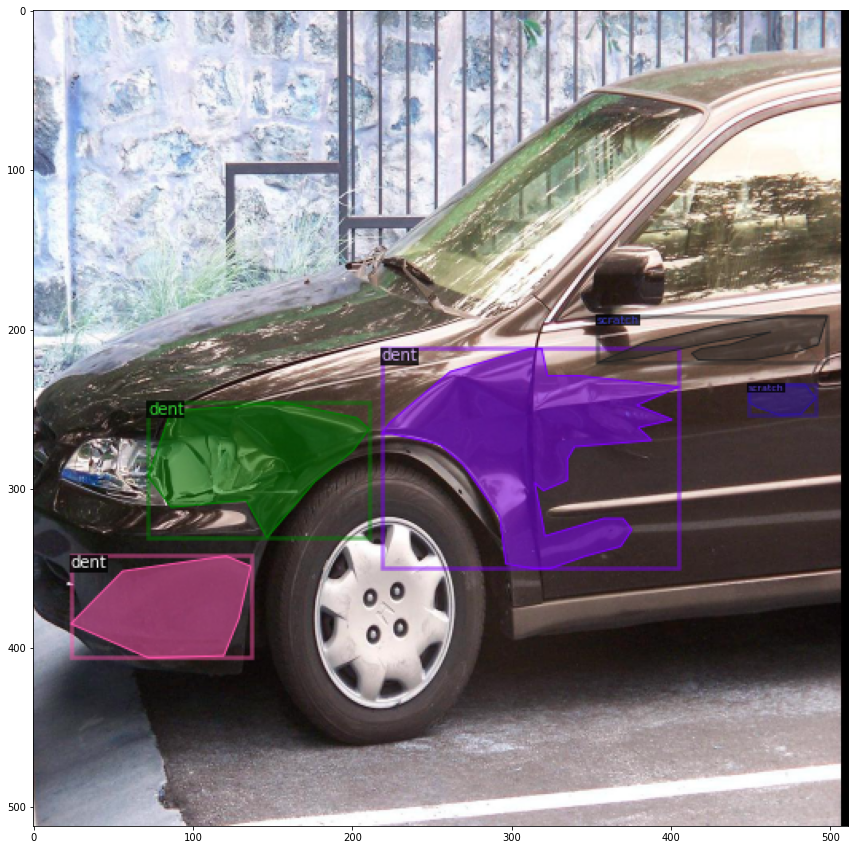

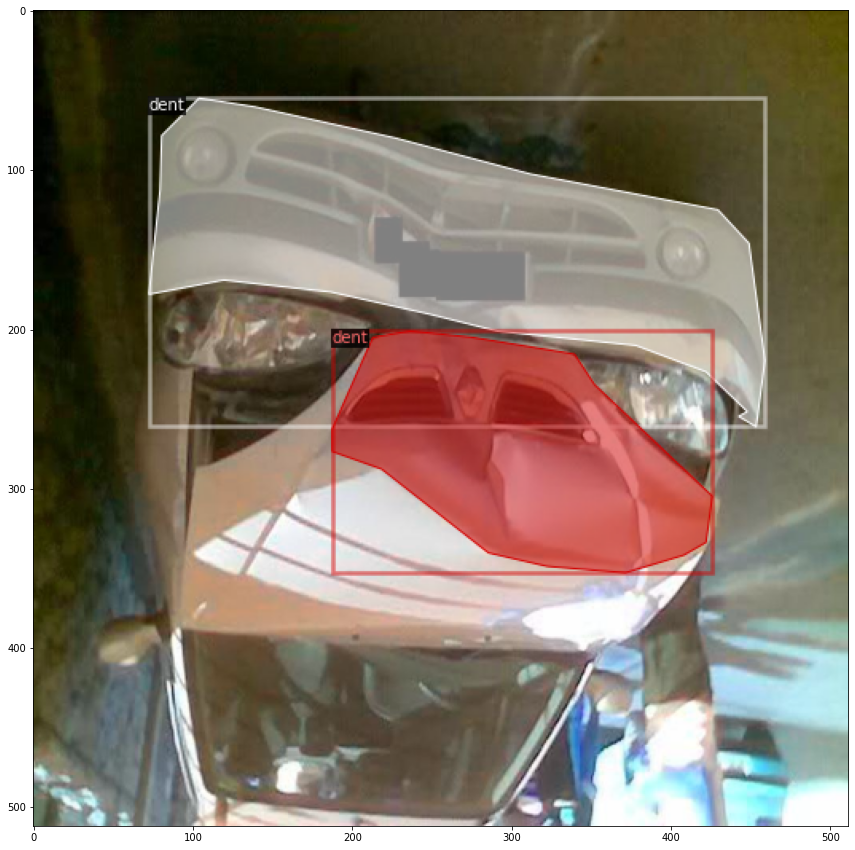

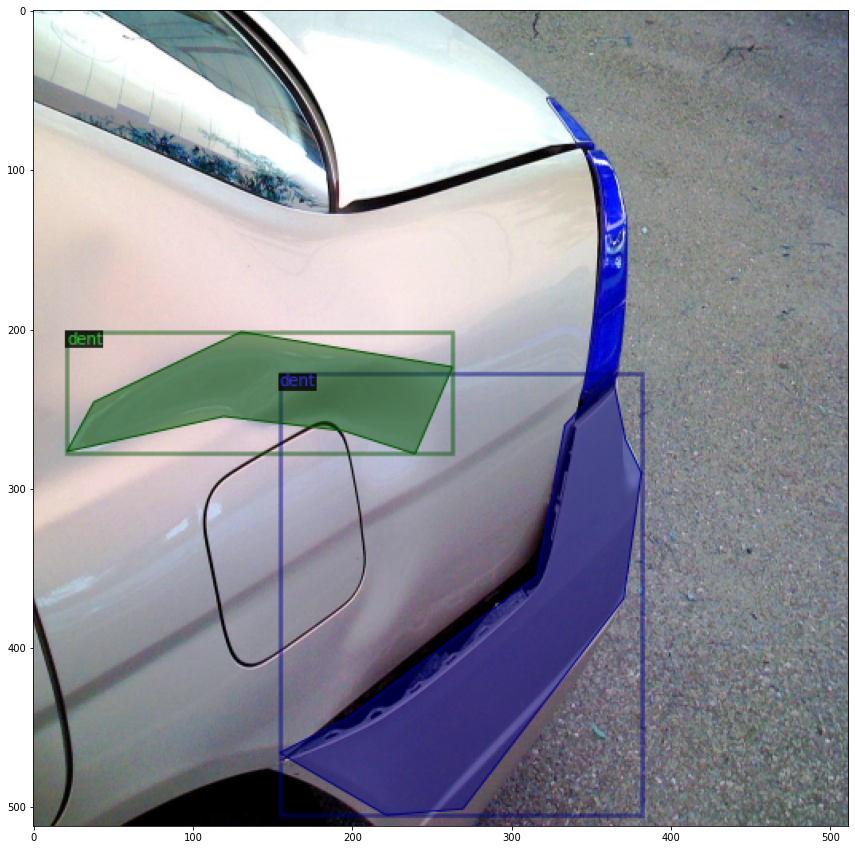

In [4]:
# Verify the data loading is correct and visualise the annotations of images
dataset_dicts = car_damage_dicts(ROOT_DIR + "dataset/" + STR_img_folder_train) # training dataset

for d in random.sample(dataset_dicts, 3): # select randomly samples in a training set
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata = damage_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    plt.figure(figsize = (15,15))
    plt.imshow(vis.get_image()[:, :, ::-1])
    plt.show()

## <br><b> 2. Fine-tune Pretrained Mask R-CNN Models

In [ ]:
# ---------------------------------------------------
# Set baseline values for conducting an experiment
# ---------------------------------------------------
PARAM_lr = 5e-5
PARAM_iter = 1000
PARAM_batch_sieze = 512
PARAM_workers = 2
PARAM_per_batch = 2
PARAM_classes = 2

#### <b>[Improvement]</b> Image Augmentation during Training Time

In [ ]:
# ----------------------------------------------------------------------------------------
# Write a Custom Dataloader for Image Augmentation during Training Time
# Using a different "mapper" with build_detection_{train,test}_loader(mapper=) works 
# for most use cases of custom data loading
# ----------------------------------------------------------------------------------------
from detectron2.data import build_detection_train_loader
from detectron2.data import transforms as T
from detectron2.data import detection_utils as utils
import torch
import copy

def custom_mapper(input_dict):
    dataset_dict = copy.deepcopy(input_dict)  # it will be modified by code below
    image = utils.read_image(dataset_dict["file_name"], format="BGR")
    transform_list = [T.RandomFlip(prob=0.5, horizontal=True, vertical=False), # Random horizontal flip
                      T.RandomFlip(prob=0.5, horizontal=False, vertical=True), # Random vertical flip
                      ]
    image, transforms = T.apply_transform_gens(transform_list, image)
    dataset_dict["image"] = torch.as_tensor(image.transpose(2, 0, 1).astype("float32"))
    annos = [
        utils.transform_instance_annotations(obj, transforms, image.shape[:2])
        for obj in dataset_dict.pop("annotations")
    ]
    instances = utils.annotations_to_instances(annos, image.shape[:2])
    dataset_dict["instances"] = utils.filter_empty_instances(instances)
    # print("Data Augmentation...")
    return dataset_dict

# Use a Custom Dataloader
# In order to adopt DefaultTrainer, overwrite its build_{train,test}_loader method to use your own dataloader
# Rather than "trainer = DefaultTrainer(cfg)", use "trainer =  Trainer(cfg)"

class Trainer(DefaultTrainer):
    @classmethod
    def build_train_loader(cls, cfg):
      # Use custom_mapper, not the Default_mapper of 'DatasetMapper'
      return build_detection_train_loader(cfg, mapper = custom_mapper) 

### 1) COCO Mask R-CNN <b>ResNet-50 FPN 1x</b> Backbone

#### <b>[Step1]</b> Train, Fine-tune a coco-pretrained Mask R-CNN model on the 'car damage' dataset

In [7]:
# Train the model
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_1x.yaml"))
cfg.DATASETS.TRAIN = ("dataset_" + STR_img_folder_train,) # "dataset_" + image folder name
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = PARAM_workers # On Windows: 0 (zero)
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_1x.yaml")
cfg.SOLVER.IMS_PER_BATCH = PARAM_per_batch
cfg.SOLVER.BASE_LR = PARAM_lr
cfg.SOLVER.MAX_ITER = PARAM_iter    # 300 iterations
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = PARAM_batch_sieze   # default: 512
cfg.MODEL.ROI_HEADS.NUM_CLASSES = PARAM_classes  # two classes: class 0 - scratch, 1 - dent

# Add some parameters
cfg.SOLVER.STEPS = (500, 1000)
cfg.SOLVER.GAMMA = 0.05
cfg.SOLVER.WARMUP_ITERS = 500

os.makedirs(cfg.OUTPUT_DIR, exist_ok = True)
trainer =  Trainer(cfg)
# trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume = False)
trainer.train()

[05/05 11:41:21 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_a54504.pkl: 178MB [00:02, 62.7MB/s]                           
'roi_heads.box_predictor.cls_score.weight' has shape (81, 1024) in the checkpoint but (3, 1024) in the model! Skipped.
'roi_heads.box_predictor.cls_score.bias' has shape (81,) in the checkpoint but (3,) in the model! Skipped.
'roi_heads.box_predictor.bbox_pred.weight' has shape (320, 1024) in the checkpoint but (8, 1024) in the model! Skipped.
'roi_heads.box_predictor.bbox_pred.bias' has shape (320,) in the checkpoint but (8,) in the model! Skipped.
'roi_heads.mask_head.predictor.weight' has shape (80, 256, 1, 1) in the checkpoint but (2, 256, 1, 1) in the model! Skipped.
'roi_heads.mask_head.predictor.bias' has shape (80,) in the checkpoint but (2,) in the model! Skipped.


[05/05 11:41:38 d2.engine.train_loop]: Starting training from iteration 0
[05/05 11:41:46 d2.utils.events]:  eta: 0:06:09  iter: 19  total_loss: 2.184  loss_cls: 1.276  loss_box_reg: 0.107  loss_mask: 0.694  loss_rpn_cls: 0.041  loss_rpn_loc: 0.021  time: 0.3798  data_time: 0.0233  lr: 0.000002  max_mem: 2701M
[05/05 11:41:54 d2.utils.events]:  eta: 0:06:02  iter: 39  total_loss: 2.148  loss_cls: 1.225  loss_box_reg: 0.146  loss_mask: 0.694  loss_rpn_cls: 0.062  loss_rpn_loc: 0.021  time: 0.3806  data_time: 0.0067  lr: 0.000004  max_mem: 2701M
[05/05 11:42:02 d2.utils.events]:  eta: 0:05:53  iter: 59  total_loss: 2.066  loss_cls: 1.133  loss_box_reg: 0.122  loss_mask: 0.693  loss_rpn_cls: 0.065  loss_rpn_loc: 0.019  time: 0.3797  data_time: 0.0065  lr: 0.000006  max_mem: 2701M
[05/05 11:42:09 d2.utils.events]:  eta: 0:05:46  iter: 79  total_loss: 1.920  loss_cls: 0.987  loss_box_reg: 0.107  loss_mask: 0.692  loss_rpn_cls: 0.042  loss_rpn_loc: 0.019  time: 0.3785  data_time: 0.0065  lr:

In [8]:
# Check training curves in tensorboard
# Before run this script, execute "cd Car_Damage", "tensorboard --logdir output" in anaconda prompt command lines
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

#### <b>[Step2]</b> Evaluation with the Trained Model

In [9]:
# Evaluate its performance using AP metric implemented in COCO API (ex. AP of ~70%)
# Use a COCO format json file
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader

evaluator = COCOEvaluator(STR_dataset_name_coco_val, cfg, False, output_dir="output")
val_loader = build_detection_test_loader(cfg, STR_dataset_name_coco_val)
inference_on_dataset(trainer.model, val_loader, evaluator)

[05/05 11:48:04 d2.data.datasets.coco]: Loaded 8 images in COCO format from /content/gdrive/My Drive/Car_Damage/dataset/annotations/val_base_coco.json
[05/05 11:48:04 d2.data.build]: Distribution of instances among all 2 categories:
|  category  | #instances   |  category  | #instances   |
|:----------:|:-------------|:----------:|:-------------|
|    dent    | 8            |  scratch   | 3            |
|            |              |            |              |
|   total    | 11           |            |              |
[05/05 11:48:04 d2.data.common]: Serializing 8 elements to byte tensors and concatenating them all ...
[05/05 11:48:04 d2.data.common]: Serialized dataset takes 0.01 MiB
[05/05 11:48:04 d2.evaluation.evaluator]: Start inference on 8 images
[05/05 11:48:06 d2.evaluation.evaluator]: Total inference time: 0:00:00.462958 (0.154319 s / img per device, on 1 devices)
[05/05 11:48:06 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:00 (0.062304 s / img per device,

OrderedDict([('bbox',
              {'AP': 0.9944708756589944,
               'AP-dent': 1.8927607046418926,
               'AP-scratch': 0.09618104667609617,
               'AP50': 5.682139642535681,
               'AP75': 0.0,
               'APl': 1.244180221593588,
               'APm': 0.0,
               'APs': nan}),
             ('segm',
              {'AP': 0.0,
               'AP-dent': 0.0,
               'AP-scratch': 0.0,
               'AP50': 0.0,
               'AP75': 0.0,
               'APl': 0.0,
               'APm': 0.0,
               'APs': nan})])

#### <b>[Step3]</b> Inference - Randomly select samples to visualize the prediction results

In [10]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
print(cfg.MODEL.WEIGHTS)
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set the testing threshold for this model
cfg.DATASETS.TEST = (STR_dataset_name_val, )
predictor = DefaultPredictor(cfg)

./output/model_final.pth


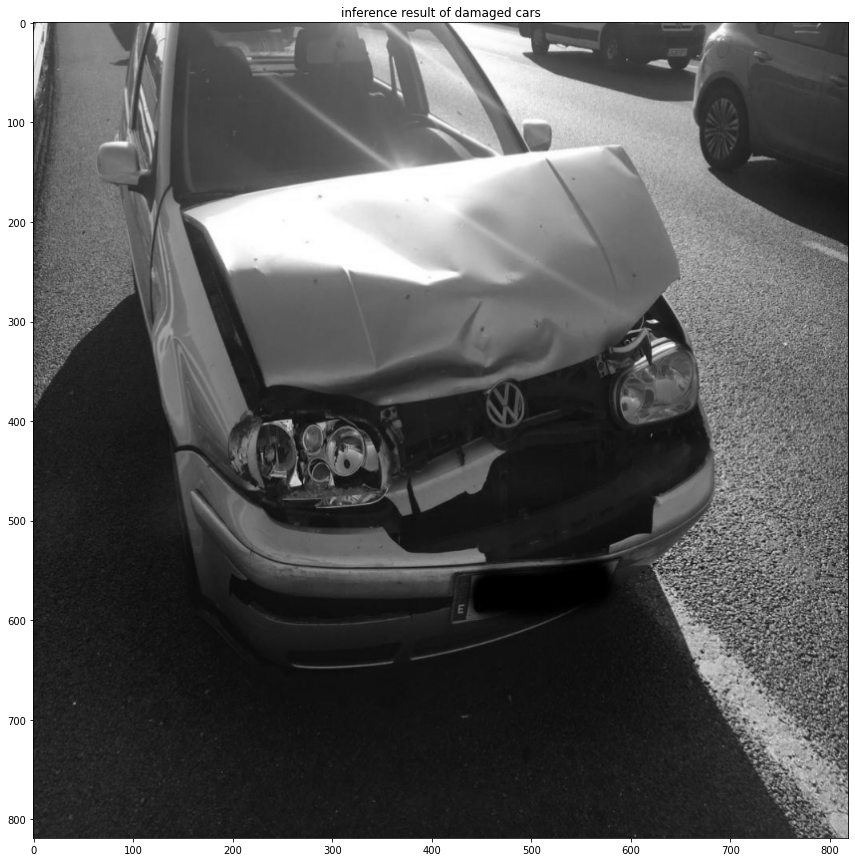

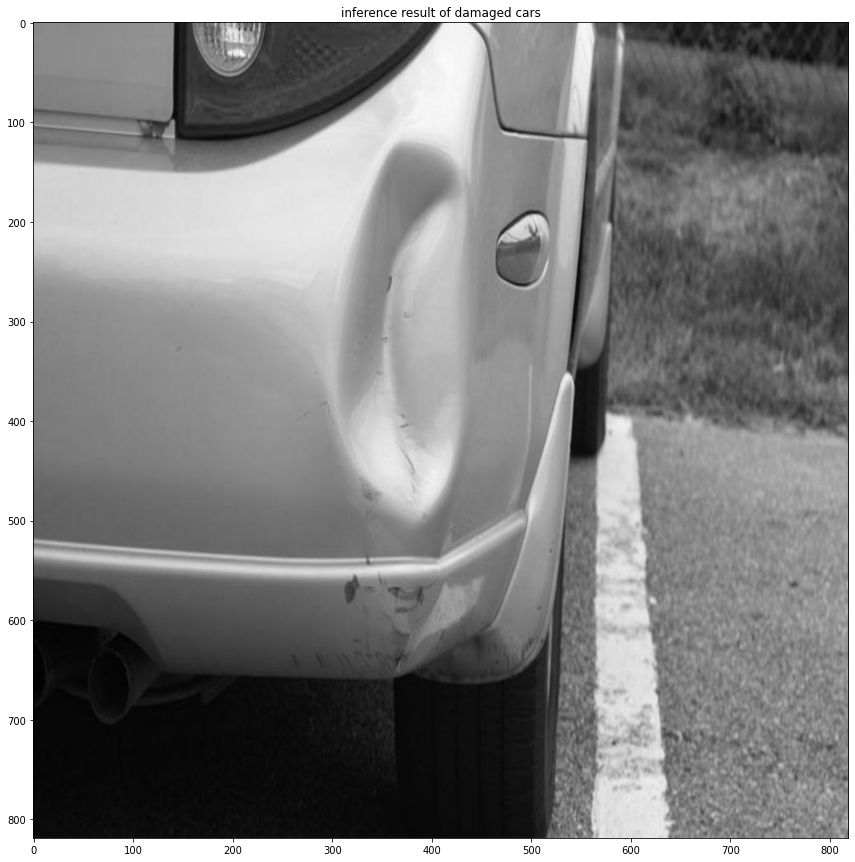

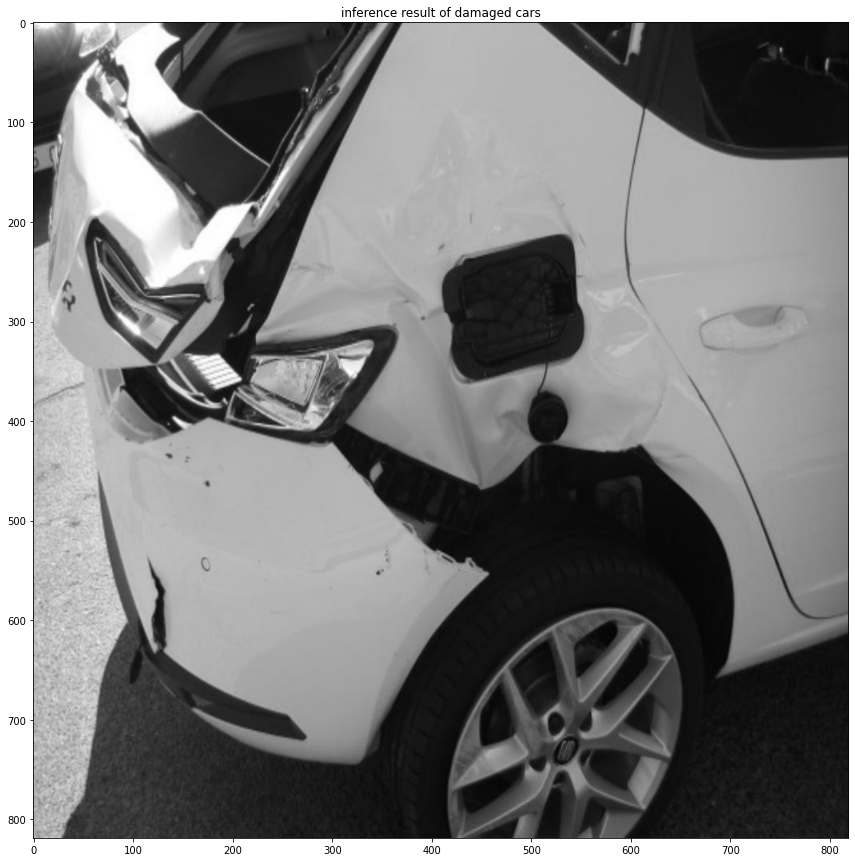

In [11]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts = car_damage_dicts(ROOT_DIR + "dataset/" + STR_img_folder_val)
for d in random.sample(dataset_dicts, 3):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=damage_metadata, 
                   scale=0.8, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  
    plt.figure(figsize=(15,15))
    plt.imshow(v.get_image()[:, :, ::-1])
    plt.title('inference result of damaged cars')
    plt.show()

In [12]:
# Throughput performance
import time
times = []
for i in range(20):
    start_time = time.time()
    outputs = predictor(im)
    delta = time.time() - start_time
    times.append(delta)
mean_delta = np.array(times).mean()
fps = 1 / mean_delta
print("Average(sec):{:.2f},fps:{:.2f}".format(mean_delta, fps))

Average(sec):0.07,fps:14.42


---------------------------------------------------------------------------------------------------------------------------------------------------------
### 2) COCO Mask R-CNN <b>ResNet-50 FPN 3x</b> Backbone

#### <b>[Step1]</b> Train, Fine-tune a coco-pretrained Mask R-CNN model on the 'car damage' dataset

In [13]:
# Train the model
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("dataset_" + STR_img_folder_train,)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = PARAM_workers # On Windows
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")
cfg.SOLVER.IMS_PER_BATCH = PARAM_per_batch
cfg.SOLVER.BASE_LR = PARAM_lr
cfg.SOLVER.MAX_ITER = PARAM_iter    # 300 iterations
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = PARAM_batch_sieze   # default: 512
cfg.MODEL.ROI_HEADS.NUM_CLASSES = PARAM_classes  # two classes: class 0 - scratch, 1 - dent

# Add some parameters
cfg.SOLVER.STEPS = (500, 1000)
cfg.SOLVER.GAMMA = 0.05
cfg.SOLVER.WARMUP_ITERS = 500

os.makedirs(cfg.OUTPUT_DIR, exist_ok = True)
trainer =  Trainer(cfg)
# trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume = False)
trainer.train()

[05/05 11:48:12 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_f10217.pkl: 178MB [00:02, 66.7MB/s]                           
'roi_heads.box_predictor.cls_score.weight' has shape (81, 1024) in the checkpoint but (3, 1024) in the model! Skipped.
'roi_heads.box_predictor.cls_score.bias' has shape (81,) in the checkpoint but (3,) in the model! Skipped.
'roi_heads.box_predictor.bbox_pred.weight' has shape (320, 1024) in the checkpoint but (8, 1024) in the model! Skipped.
'roi_heads.box_predictor.bbox_pred.bias' has shape (320,) in the checkpoint but (8,) in the model! Skipped.
'roi_heads.mask_head.predictor.weight' has shape (80, 256, 1, 1) in the checkpoint but (2, 256, 1, 1) in the model! Skipped.
'roi_heads.mask_head.predictor.bias' has shape (80,) in the checkpoint but (2,) in the model! Skipped.


[05/05 11:48:21 d2.engine.train_loop]: Starting training from iteration 0
[05/05 11:48:29 d2.utils.events]:  eta: 0:06:03  iter: 19  total_loss: 1.865  loss_cls: 0.957  loss_box_reg: 0.122  loss_mask: 0.694  loss_rpn_cls: 0.063  loss_rpn_loc: 0.018  time: 0.3779  data_time: 0.0210  lr: 0.000002  max_mem: 2868M
[05/05 11:48:36 d2.utils.events]:  eta: 0:05:59  iter: 39  total_loss: 1.812  loss_cls: 0.931  loss_box_reg: 0.123  loss_mask: 0.693  loss_rpn_cls: 0.046  loss_rpn_loc: 0.022  time: 0.3768  data_time: 0.0066  lr: 0.000004  max_mem: 2868M
[05/05 11:48:44 d2.utils.events]:  eta: 0:05:52  iter: 59  total_loss: 1.783  loss_cls: 0.850  loss_box_reg: 0.148  loss_mask: 0.692  loss_rpn_cls: 0.074  loss_rpn_loc: 0.023  time: 0.3769  data_time: 0.0068  lr: 0.000006  max_mem: 2868M
[05/05 11:48:51 d2.utils.events]:  eta: 0:05:43  iter: 79  total_loss: 1.614  loss_cls: 0.711  loss_box_reg: 0.126  loss_mask: 0.692  loss_rpn_cls: 0.018  loss_rpn_loc: 0.019  time: 0.3765  data_time: 0.0066  lr:

In [14]:
# Check training curves in tensorboard
# Before run this script, execute "cd Car_Damage", "tensorboard --logdir output" in anaconda prompt command lines
%load_ext tensorboard
%tensorboard --logdir output

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 819), started 0:06:40 ago. (Use '!kill 819' to kill it.)

<IPython.core.display.Javascript object>

#### <b>[Step2]</b> Evaluation with the Trained Model

In [15]:
# Evaluate its performance using AP metric implemented in COCO API (ex. AP of ~70%)
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader

evaluator = COCOEvaluator(STR_dataset_name_coco_val, cfg, False, output_dir="output")
val_loader = build_detection_test_loader(cfg, STR_dataset_name_coco_val)
inference_on_dataset(trainer.model, val_loader, evaluator)

[05/05 11:54:43 d2.data.datasets.coco]: Loaded 8 images in COCO format from /content/gdrive/My Drive/Car_Damage/dataset/annotations/val_base_coco.json
[05/05 11:54:43 d2.data.common]: Serializing 8 elements to byte tensors and concatenating them all ...
[05/05 11:54:43 d2.data.common]: Serialized dataset takes 0.01 MiB
[05/05 11:54:43 d2.evaluation.evaluator]: Start inference on 8 images
[05/05 11:54:44 d2.evaluation.evaluator]: Total inference time: 0:00:00.476133 (0.158711 s / img per device, on 1 devices)
[05/05 11:54:44 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:00 (0.061153 s / img per device, on 1 devices)
[05/05 11:54:44 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[05/05 11:54:44 d2.evaluation.coco_evaluation]: Saving results to output/coco_instances_results.json
[05/05 11:54:44 d2.evaluation.coco_evaluation]: Evaluating predictions ...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per im

OrderedDict([('bbox',
              {'AP': 0.5242590006614658,
               'AP-dent': 1.0485180013229316,
               'AP-scratch': 0.0,
               'AP50': 2.509055783627143,
               'AP75': 0.0,
               'APl': 0.7414339406913664,
               'APm': 0.0,
               'APs': nan}),
             ('segm',
              {'AP': 0.0,
               'AP-dent': 0.0,
               'AP-scratch': 0.0,
               'AP50': 0.0,
               'AP75': 0.0,
               'APl': 0.0,
               'APm': 0.0,
               'APs': nan})])

#### <b>[Step3]</b> Inference - Randomly select samples to visualize the prediction results

In [16]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
print(cfg.MODEL.WEIGHTS)
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set the testing threshold for this model
cfg.DATASETS.TEST = (STR_dataset_name_val, )
predictor = DefaultPredictor(cfg)

./output/model_final.pth


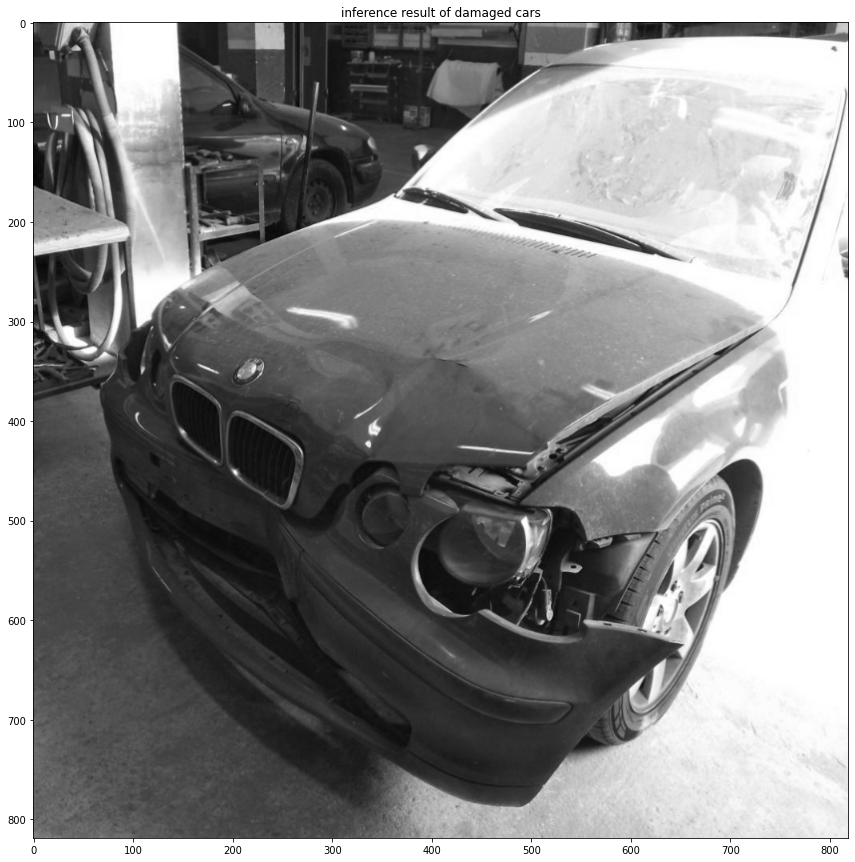

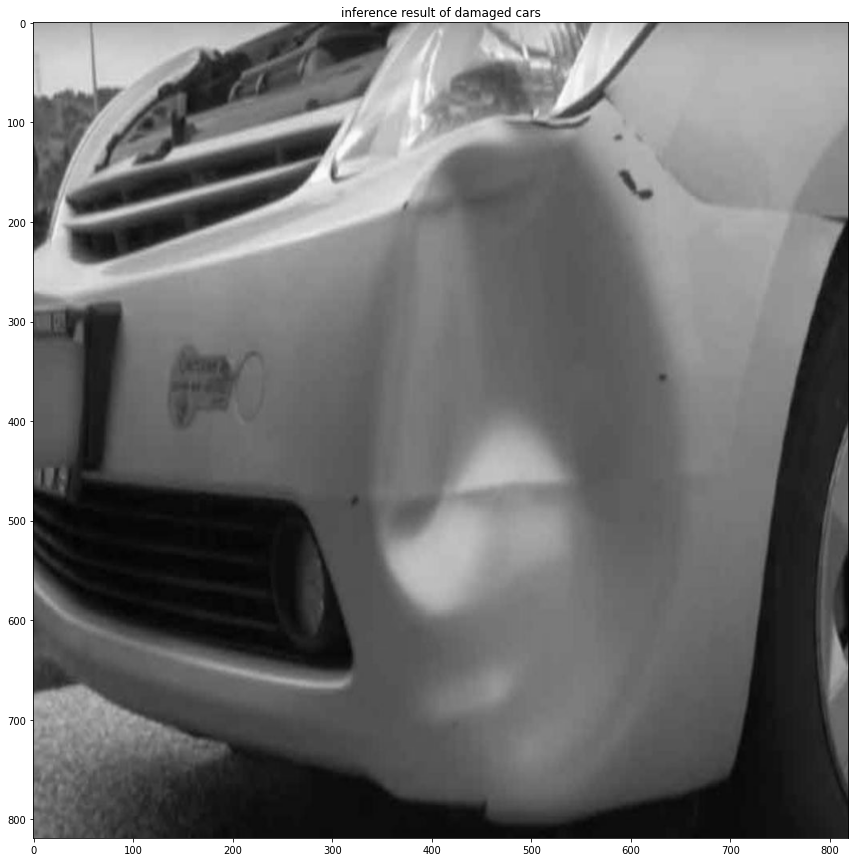

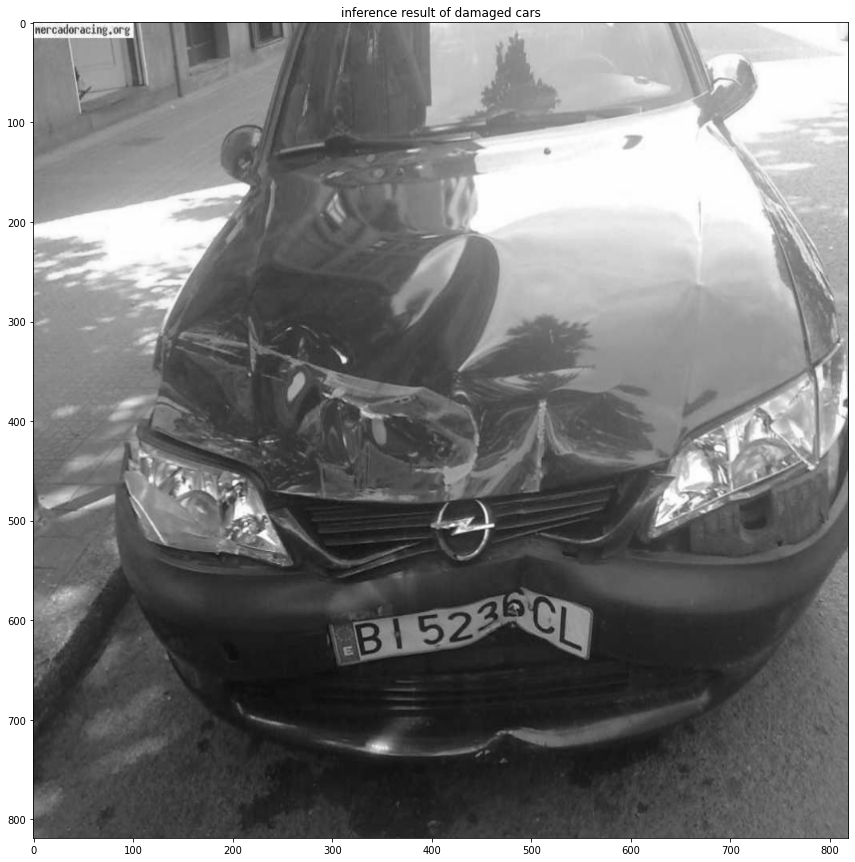

In [17]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts = car_damage_dicts(ROOT_DIR + "dataset/" + STR_img_folder_val)
for d in random.sample(dataset_dicts, 3):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=damage_metadata, 
                   scale=0.8, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  
    plt.figure(figsize=(15,15))
    plt.imshow(v.get_image()[:, :, ::-1])
    plt.title('inference result of damaged cars')
    plt.show()

In [19]:
# Throughput performance
import time
times = []
for i in range(20):
    start_time = time.time()
    outputs = predictor(im)
    delta = time.time() - start_time
    times.append(delta)
mean_delta = np.array(times).mean()
fps = 1 / mean_delta
print("Average(sec):{:.2f},fps:{:.2f}".format(mean_delta, fps))

Average(sec):0.07,fps:14.48


---------------------------------------------------------------------------------------------------------------------------------------------------------
### 3) COCO Mask R-CNN <b>ResNet-101 FPN 3x</b> Backbone

#### <b>[Step1]</b> Train, Fine-tune a coco-pretrained Mask R-CNN model on the 'car damage' dataset

In [20]:
# Train the model
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("dataset_" + STR_img_folder_train,)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = PARAM_workers # On Windows
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml")
cfg.SOLVER.IMS_PER_BATCH = PARAM_per_batch
cfg.SOLVER.BASE_LR = PARAM_lr
cfg.SOLVER.MAX_ITER = PARAM_iter    # 300 iterations
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = PARAM_batch_sieze   # default: 512
cfg.MODEL.ROI_HEADS.NUM_CLASSES = PARAM_classes  # two classes: class 0 - scratch, 1 - dent

# Add some parameters
cfg.SOLVER.STEPS = (500, 1000)
cfg.SOLVER.GAMMA = 0.05
cfg.SOLVER.WARMUP_ITERS = 500

os.makedirs(cfg.OUTPUT_DIR, exist_ok = True)
trainer =  Trainer(cfg)
# trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume = False)
trainer.train()

[05/05 11:54:50 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_a3ec72.pkl: 254MB [00:03, 72.9MB/s]                           
'roi_heads.box_predictor.cls_score.weight' has shape (81, 1024) in the checkpoint but (3, 1024) in the model! Skipped.
'roi_heads.box_predictor.cls_score.bias' has shape (81,) in the checkpoint but (3,) in the model! Skipped.
'roi_heads.box_predictor.bbox_pred.weight' has shape (320, 1024) in the checkpoint but (8, 1024) in the model! Skipped.
'roi_heads.box_predictor.bbox_pred.bias' has shape (320,) in the checkpoint but (8,) in the model! Skipped.
'roi_heads.mask_head.predictor.weight' has shape (80, 256, 1, 1) in the checkpoint but (2, 256, 1, 1) in the model! Skipped.
'roi_heads.mask_head.predictor.bias' has shape (80,) in the checkpoint but (2,) in the model! Skipped.


[05/05 11:55:00 d2.engine.train_loop]: Starting training from iteration 0
[05/05 11:55:11 d2.utils.events]:  eta: 0:08:25  iter: 19  total_loss: 1.982  loss_cls: 1.066  loss_box_reg: 0.109  loss_mask: 0.693  loss_rpn_cls: 0.066  loss_rpn_loc: 0.019  time: 0.5179  data_time: 0.0143  lr: 0.000002  max_mem: 3904M
[05/05 11:55:21 d2.utils.events]:  eta: 0:08:15  iter: 39  total_loss: 1.901  loss_cls: 1.015  loss_box_reg: 0.126  loss_mask: 0.693  loss_rpn_cls: 0.043  loss_rpn_loc: 0.017  time: 0.5188  data_time: 0.0068  lr: 0.000004  max_mem: 3904M
[05/05 11:55:32 d2.utils.events]:  eta: 0:08:05  iter: 59  total_loss: 1.795  loss_cls: 0.922  loss_box_reg: 0.123  loss_mask: 0.694  loss_rpn_cls: 0.039  loss_rpn_loc: 0.016  time: 0.5192  data_time: 0.0065  lr: 0.000006  max_mem: 3904M
[05/05 11:55:42 d2.utils.events]:  eta: 0:07:54  iter: 79  total_loss: 1.736  loss_cls: 0.770  loss_box_reg: 0.123  loss_mask: 0.693  loss_rpn_cls: 0.093  loss_rpn_loc: 0.028  time: 0.5198  data_time: 0.0064  lr:

In [21]:
# Check training curves in tensorboard
# Before run this script, execute "cd Car_Damage", "tensorboard --logdir output" in anaconda prompt command lines
%load_ext tensorboard
%tensorboard --logdir output

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 819), started 0:15:44 ago. (Use '!kill 819' to kill it.)

<IPython.core.display.Javascript object>

#### <b>[Step2]</b> Evaluation with the Trained Model

In [22]:
# Evaluate its performance using AP metric implemented in COCO API (ex. AP of ~70%)
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader

evaluator = COCOEvaluator(STR_dataset_name_coco_val, cfg, False, output_dir="output")
val_loader = build_detection_test_loader(cfg, STR_dataset_name_coco_val)
inference_on_dataset(trainer.model, val_loader, evaluator)

[05/05 12:03:47 d2.data.datasets.coco]: Loaded 8 images in COCO format from /content/gdrive/My Drive/Car_Damage/dataset/annotations/val_base_coco.json
[05/05 12:03:47 d2.data.common]: Serializing 8 elements to byte tensors and concatenating them all ...
[05/05 12:03:47 d2.data.common]: Serialized dataset takes 0.01 MiB
[05/05 12:03:47 d2.evaluation.evaluator]: Start inference on 8 images
[05/05 12:03:49 d2.evaluation.evaluator]: Total inference time: 0:00:00.572449 (0.190816 s / img per device, on 1 devices)
[05/05 12:03:49 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:00 (0.081379 s / img per device, on 1 devices)
[05/05 12:03:49 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[05/05 12:03:49 d2.evaluation.coco_evaluation]: Saving results to output/coco_instances_results.json
[05/05 12:03:49 d2.evaluation.coco_evaluation]: Evaluating predictions ...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per im

OrderedDict([('bbox',
              {'AP': 1.7599211140626256,
               'AP-dent': 3.1914191419141917,
               'AP-scratch': 0.32842308621106014,
               'AP50': 4.03364726716574,
               'AP75': 0.41978588102712705,
               'APl': 2.7814208659671937,
               'APm': 0.0,
               'APs': nan}),
             ('segm',
              {'AP': 0.10263221444095627,
               'AP-dent': 0.0,
               'AP-scratch': 0.2052644288819126,
               'AP50': 0.20526442888191254,
               'AP75': 0.0,
               'APl': 0.4032258064516127,
               'APm': 0.0,
               'APs': nan})])

#### <b>[Step3]</b> Inference - Randomly select samples to visualize the prediction results

In [23]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
print(cfg.MODEL.WEIGHTS)
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set the testing threshold for this model
cfg.DATASETS.TEST = (STR_dataset_name_val, )
predictor = DefaultPredictor(cfg)

./output/model_final.pth


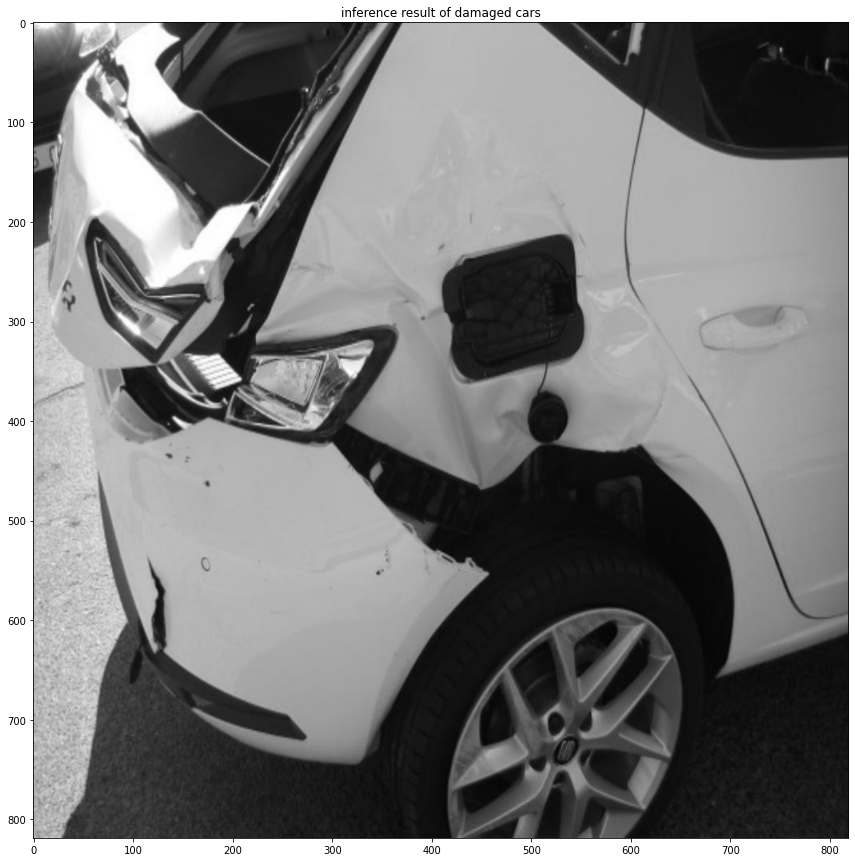

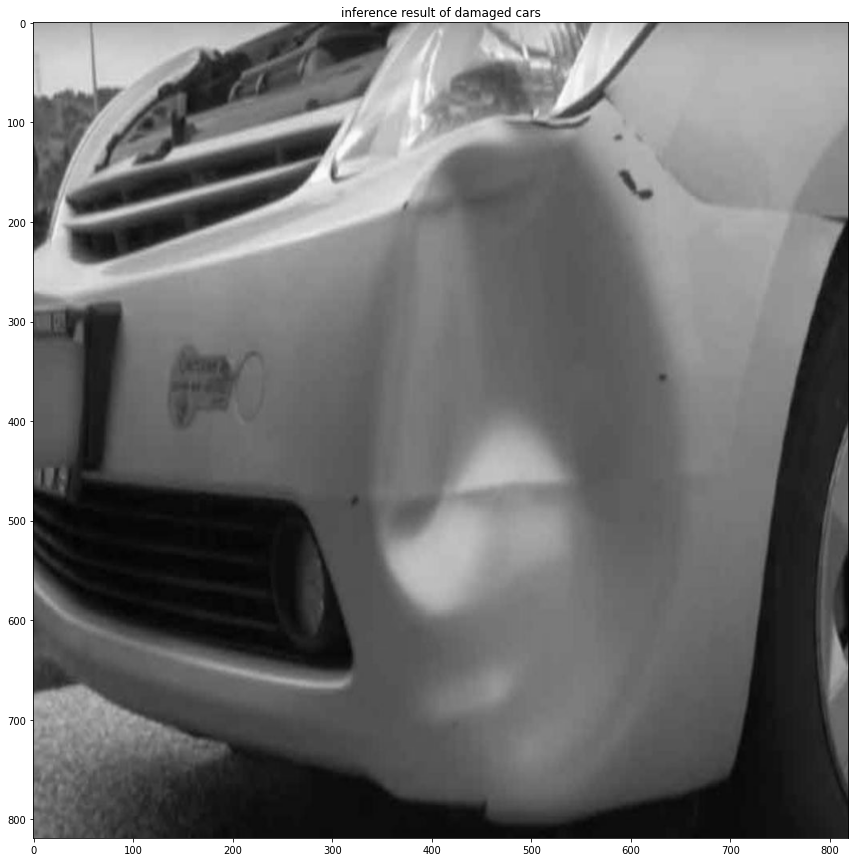

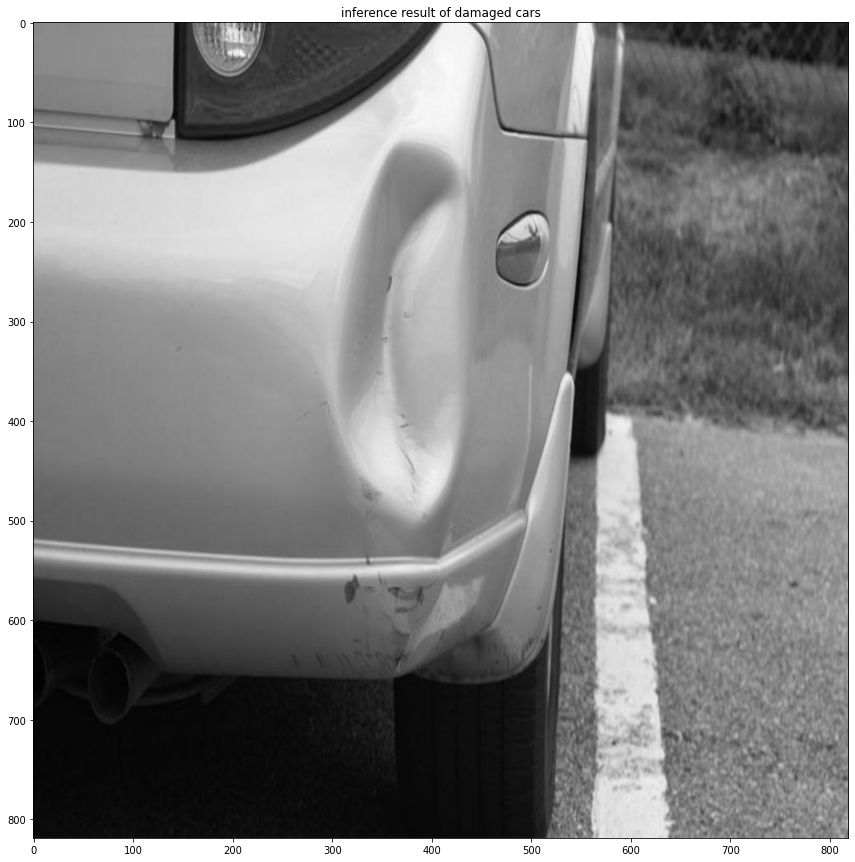

In [24]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts = car_damage_dicts(ROOT_DIR + "dataset/" + STR_img_folder_val)
for d in random.sample(dataset_dicts, 3):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=damage_metadata, 
                   scale=0.8, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  
    plt.figure(figsize=(15,15))
    plt.imshow(v.get_image()[:, :, ::-1])
    plt.title('inference result of damaged cars')
    plt.show()

In [25]:
# Throughput performance
import time
times = []
for i in range(20):
    start_time = time.time()
    outputs = predictor(im)
    delta = time.time() - start_time
    times.append(delta)
mean_delta = np.array(times).mean()
fps = 1 / mean_delta
print("Average(sec):{:.2f},fps:{:.2f}".format(mean_delta, fps))

Average(sec):0.09,fps:11.24


---------------------------------------------------------------------------------------------------------------------------------------------------------
### 4) LVIS Mask R-CNN <b>ResNet-101 FPN 1x </b> Backbone

#### <b>[Step1]</b> Train, Fine-tune a LVIS-pretrained Mask R-CNN model on the 'car damage' dataset

In [26]:
# Train the model
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("LVIS-InstanceSegmentation/mask_rcnn_R_101_FPN_1x.yaml"))
cfg.DATASETS.TRAIN = ("dataset_" + STR_img_folder_train,)
cfg.DATASETS.TEST = ()
cfg.DATALOADER.NUM_WORKERS = PARAM_workers # On Windows
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("LVIS-InstanceSegmentation/mask_rcnn_R_101_FPN_1x.yaml")
cfg.SOLVER.IMS_PER_BATCH = PARAM_per_batch
cfg.SOLVER.BASE_LR = PARAM_lr
cfg.SOLVER.MAX_ITER = PARAM_iter    # 300 iterations
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = PARAM_batch_sieze   # default: 512
cfg.MODEL.ROI_HEADS.NUM_CLASSES = PARAM_classes  # two classes: class 0 - scratch, 1 - dent

# Add some parameters
cfg.SOLVER.STEPS = (500, 1000)
cfg.SOLVER.GAMMA = 0.05
cfg.SOLVER.WARMUP_ITERS = 500

os.makedirs(cfg.OUTPUT_DIR, exist_ok = True)
trainer =  Trainer(cfg)
# trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume = False)
trainer.train()

[05/05 12:03:55 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_824ab5.pkl: 279MB [00:04, 64.3MB/s]                           
'roi_heads.box_predictor.cls_score.weight' has shape (1231, 1024) in the checkpoint but (3, 1024) in the model! Skipped.
'roi_heads.box_predictor.cls_score.bias' has shape (1231,) in the checkpoint but (3,) in the model! Skipped.
'roi_heads.box_predictor.bbox_pred.weight' has shape (4920, 1024) in the checkpoint but (8, 1024) in the model! Skipped.
'roi_heads.box_predictor.bbox_pred.bias' has shape (4920,) in the checkpoint but (8,) in the model! Skipped.
'roi_heads.mask_head.predictor.weight' has shape (1230, 256, 1, 1) in the checkpoint but (2, 256, 1, 1) in the model! Skipped.
'roi_heads.mask_head.predictor.bias' has shape (1230,) in the checkpoint but (2,) in the model! Skipped.


[05/05 12:04:07 d2.engine.train_loop]: Starting training from iteration 0
[05/05 12:04:17 d2.utils.events]:  eta: 0:08:20  iter: 19  total_loss: 1.919  loss_cls: 1.022  loss_box_reg: 0.111  loss_mask: 0.695  loss_rpn_cls: 0.035  loss_rpn_loc: 0.018  time: 0.5110  data_time: 0.0228  lr: 0.000002  max_mem: 3979M
[05/05 12:04:27 d2.utils.events]:  eta: 0:08:10  iter: 39  total_loss: 1.791  loss_cls: 0.884  loss_box_reg: 0.095  loss_mask: 0.692  loss_rpn_cls: 0.047  loss_rpn_loc: 0.023  time: 0.5126  data_time: 0.0066  lr: 0.000004  max_mem: 3979M
[05/05 12:04:38 d2.utils.events]:  eta: 0:08:00  iter: 59  total_loss: 1.599  loss_cls: 0.693  loss_box_reg: 0.115  loss_mask: 0.686  loss_rpn_cls: 0.036  loss_rpn_loc: 0.023  time: 0.5145  data_time: 0.0062  lr: 0.000006  max_mem: 3979M
[05/05 12:04:48 d2.utils.events]:  eta: 0:07:50  iter: 79  total_loss: 1.390  loss_cls: 0.509  loss_box_reg: 0.107  loss_mask: 0.672  loss_rpn_cls: 0.047  loss_rpn_loc: 0.023  time: 0.5162  data_time: 0.0062  lr:

In [27]:
# Check training curves in tensorboard
# Before run this script, execute "cd Car_Damage", "tensorboard --logdir output" in anaconda prompt command lines
%load_ext tensorboard
%tensorboard --logdir output

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 819), started 0:24:46 ago. (Use '!kill 819' to kill it.)

<IPython.core.display.Javascript object>

#### <b>[Step2]</b> Evaluation with the Trained Model

In [28]:
# Evaluate its performance using AP metric implemented in COCO API (ex. AP of ~70%)
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader

evaluator = COCOEvaluator(STR_dataset_name_coco_val, cfg, False, output_dir="output")
val_loader = build_detection_test_loader(cfg, STR_dataset_name_coco_val)
inference_on_dataset(trainer.model, val_loader, evaluator)

[05/05 12:12:50 d2.data.datasets.coco]: Loaded 8 images in COCO format from /content/gdrive/My Drive/Car_Damage/dataset/annotations/val_base_coco.json
[05/05 12:12:50 d2.data.common]: Serializing 8 elements to byte tensors and concatenating them all ...
[05/05 12:12:50 d2.data.common]: Serialized dataset takes 0.01 MiB
[05/05 12:12:50 d2.evaluation.evaluator]: Start inference on 8 images
[05/05 12:12:59 d2.evaluation.evaluator]: Total inference time: 0:00:03.413897 (1.137966 s / img per device, on 1 devices)
[05/05 12:12:59 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:00 (0.157148 s / img per device, on 1 devices)
[05/05 12:12:59 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[05/05 12:12:59 d2.evaluation.coco_evaluation]: Saving results to output/coco_instances_results.json
[05/05 12:12:59 d2.evaluation.coco_evaluation]: Evaluating predictions ...
Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per im

OrderedDict([('bbox',
              {'AP': 3.6872290797518534,
               'AP-dent': 7.353505856804557,
               'AP-scratch': 0.02095230269914958,
               'AP50': 7.711073557685776,
               'AP75': 3.30420625955213,
               'APl': 7.5855780632439185,
               'APm': 0.0,
               'APs': nan}),
             ('segm',
              {'AP': 1.689602969201387,
               'AP-dent': 3.3792059384027726,
               'AP-scratch': 0.0,
               'AP50': 3.581960521633559,
               'AP75': 0.0,
               'APl': 3.908521912560351,
               'APm': 0.0,
               'APs': nan})])

#### <b>[Step3]</b> Inference - Randomly select samples to visualize the prediction results

In [29]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
print(cfg.MODEL.WEIGHTS)
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set the testing threshold for this model
cfg.DATASETS.TEST = (STR_dataset_name_val, )
predictor = DefaultPredictor(cfg)

./output/model_final.pth


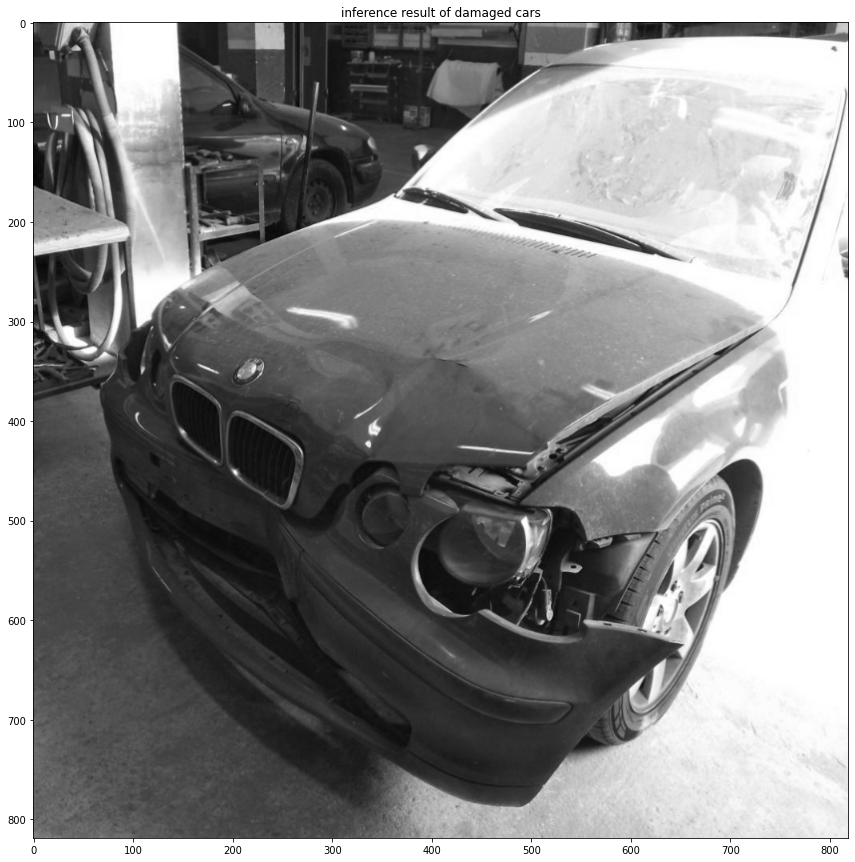

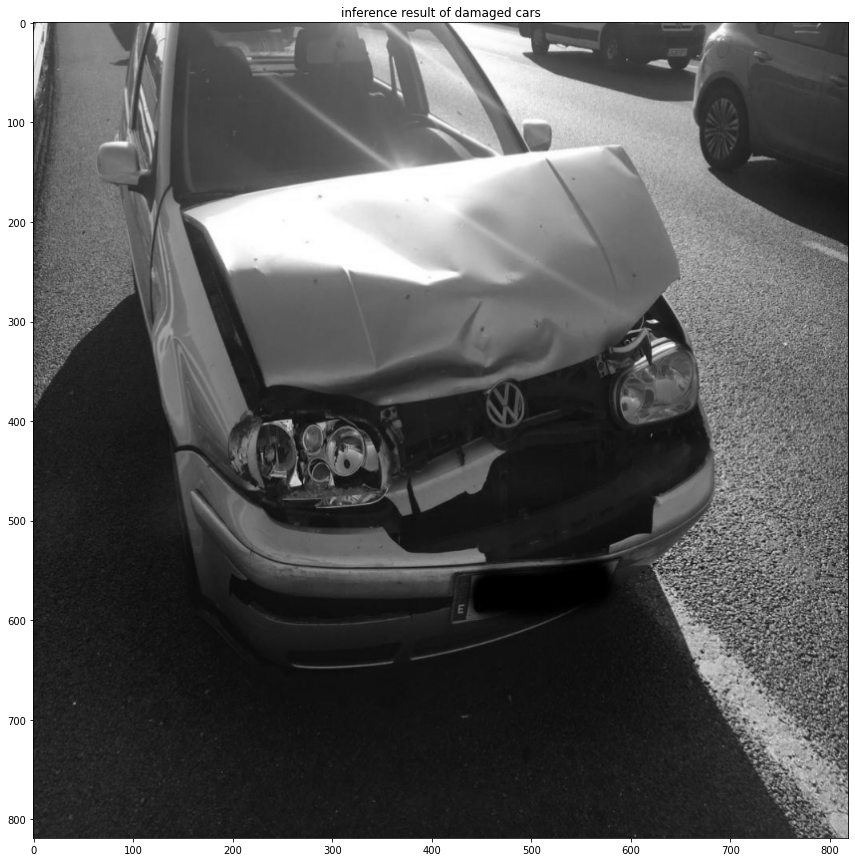

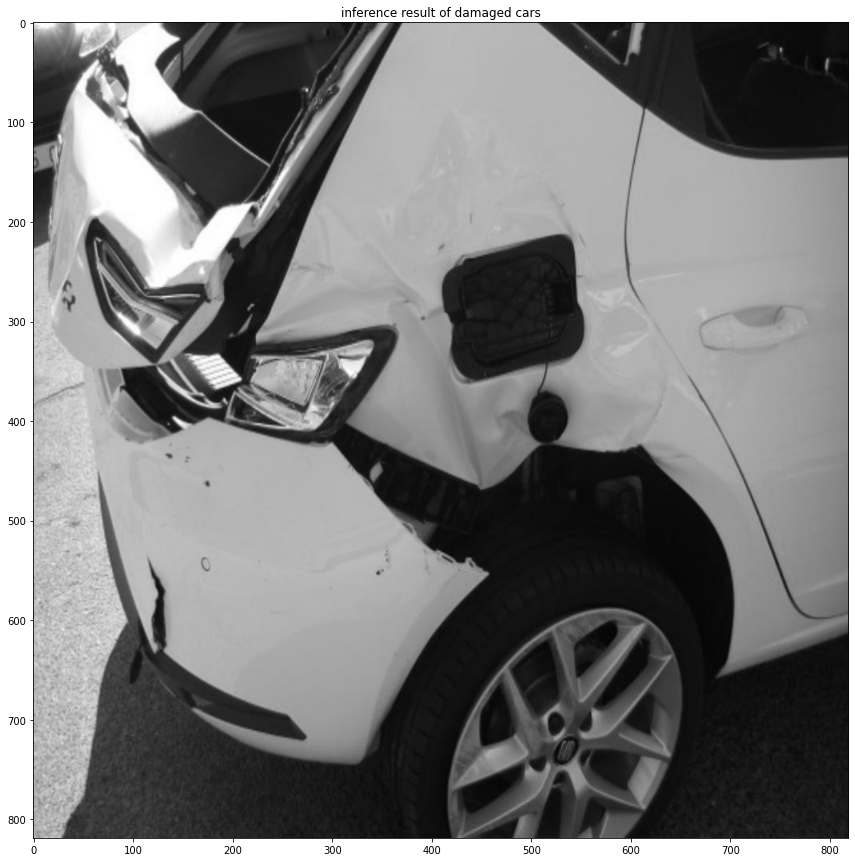

In [30]:
from detectron2.utils.visualizer import ColorMode
dataset_dicts = car_damage_dicts(ROOT_DIR + "dataset/" + STR_img_folder_val)
for d in random.sample(dataset_dicts, 3):    
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)
    v = Visualizer(im[:, :, ::-1],
                   metadata=damage_metadata, 
                   scale=0.8, 
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels
    )
    v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  
    plt.figure(figsize=(15,15))
    plt.imshow(v.get_image()[:, :, ::-1])
    plt.title('inference result of damaged cars')
    plt.show()

In [31]:
# Throughput performance
import time
times = []
for i in range(20):
    start_time = time.time()
    outputs = predictor(im)
    delta = time.time() - start_time
    times.append(delta)
mean_delta = np.array(times).mean()
fps = 1 / mean_delta
print("Average(sec):{:.2f},fps:{:.2f}".format(mean_delta, fps))

Average(sec):0.09,fps:11.35


## <br><b>References

Detectron2 contributors Revision, (2020). Detectron2 Beginner's Tutorial [online]. Google Colab.<br> [Viewed 15 March 2020]. Available from: https://colab.research.google.com/drive/16jcaJoc6bCFAQ96jDe2HwtXj7BMD_-m5<br>



-------------------------------------------------------------------------------

## <b>Set-up Environment for Development</b>


In [ ]:
# # install dependencies: (use cu101 because colab has CUDA 10.1)
# !pip install -U torch==1.5 torchvision==0.6 -f https://download.pytorch.org/whl/cu101/torch_stable.html 
# !pip install cython pyyaml==5.1
# !pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
# import torch, torchvision
# print(torch.__version__, torch.cuda.is_available())
# !gcc --version
# # opencv is pre-installed on colab

In [ ]:
# # install detectron2:
# !pip install detectron2==0.1.2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/index.html
# # You may need to restart your runtime prior to this, to let your installation take effect

In [ ]:
# !ls

In [ ]:
# from google.colab import drive 
# drive.mount('/content/gdrive/')